In [120]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import math
import itertools

import warnings
warnings.filterwarnings('ignore')

In [93]:
# Source: https://www.kaggle.com/datasets/abhijitdahatonde/real-world-smartphones-dataset
data = pd.read_csv('smartphones.csv')

# Shape of the dataset 
print(data.shape)
data.head(5)

(980, 22)


,brand_name,model,price,avg_rating,5G_or_not,processor_brand,num_cores,processor_speed,battery_capacity,fast_charging_available,...,internal_memory,screen_size,refresh_rate,num_rear_cameras,os,primary_camera_rear,primary_camera_front,extended_memory_available,resolution_height,resolution_width
0,apple,Apple iPhone 11,38999,7.3,0,bionic,6.0,2.65,3110.0,0,...,64,6.1,60,2,ios,12.0,12.0,0,1792,828
1,apple,Apple iPhone 11 (128GB),46999,7.5,0,bionic,6.0,2.65,3110.0,0,...,128,6.1,60,2,ios,12.0,12.0,0,1792,828
2,apple,Apple iPhone 11 Pro Max,109900,7.7,0,bionic,6.0,2.65,3500.0,1,...,64,6.5,60,3,ios,12.0,12.0,0,2688,1242
3,apple,Apple iPhone 12,51999,7.4,1,bionic,6.0,3.10,NaN,0,...,64,6.1,60,2,ios,12.0,12.0,0,2532,1170
4,apple,Apple iPhone 12 (128GB),55999,7.5,1,bionic,6.0,3.10,NaN,0,...,128,6.1,60,2,ios,12.0,12.0,0,2532,1170


In [94]:
missing_values = data.isnull().sum()
cols_missing = [cols for cols in data.columns if data[cols].isnull().sum() != 0]
print("Missing values in each column:\n", missing_values)

Missing values in each column:
 brand_name                     0
model                          0
price                          0
avg_rating                   101
5G_or_not                      0
processor_brand               20
num_cores                      6
processor_speed               42
battery_capacity              11
fast_charging_available        0
fast_charging                211
ram_capacity                   0
internal_memory                0
screen_size                    0
refresh_rate                   0
num_rear_cameras               0
os                            14
primary_camera_rear            0
primary_camera_front           5
extended_memory_available      0
resolution_height              0
resolution_width               0
dtype: int64


In [95]:
print(data[cols_missing].nunique())
data.nunique()

avg_rating              30
processor_brand         13
num_cores                3
processor_speed         35
battery_capacity        89
fast_charging           32
os                       3
primary_camera_front    19
dtype: int64


brand_name                    46
model                        980
price                        379
avg_rating                    30
5G_or_not                      2
processor_brand               13
num_cores                      3
processor_speed               35
battery_capacity              89
fast_charging_available        2
fast_charging                 32
ram_capacity                   9
internal_memory                8
screen_size                   79
refresh_rate                   6
num_rear_cameras               4
os                             3
primary_camera_rear           18
primary_camera_front          19
extended_memory_available      2
resolution_height             65
resolution_width              40
dtype: int64

In [96]:
# avg_rating using mean of avg_rating within each brand_name
data['avg_rating'] = data.groupby('brand_name')['avg_rating'].transform(lambda x: x.fillna(x.mean()))
data['avg_rating'].fillna(data['avg_rating'].mean(), inplace=True)
# processor_speed using mode within each processor_brand
data['processor_speed'] = data.groupby('processor_brand')['processor_speed'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else np.nan))

# fast_charging using mode within each brand_name
data['fast_charging'] = data.groupby('brand_name')['fast_charging'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else 'No'))

# num_cores using mode within each processor_brand
data['num_cores'] = data.groupby('processor_brand')['num_cores'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else np.nan))

# primary_camera_front using mode within each brand_name
data['primary_camera_front'] = data.groupby('brand_name')['primary_camera_front'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else np.nan))

In [123]:
# the price column has positive skew
data['price'].skew()

6.591790999665569

In [97]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 980 entries, 0 to 979
Data columns (total 22 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   brand_name                 980 non-null    object 
 1   model                      980 non-null    object 
 2   price                      980 non-null    int64  
 3   avg_rating                 980 non-null    float64
 4   5G_or_not                  980 non-null    int64  
 5   processor_brand            960 non-null    object 
 6   num_cores                  960 non-null    float64
 7   processor_speed            960 non-null    float64
 8   battery_capacity           969 non-null    float64
 9   fast_charging_available    980 non-null    int64  
 10  fast_charging              980 non-null    object 
 11  ram_capacity               980 non-null    int64  
 12  internal_memory            980 non-null    int64  
 13  screen_size                980 non-null    float64

In [98]:
# Remove duplicate records
duplicates = data.duplicated().sum()
print("Number of duplicate rows:", duplicates)
data = data.drop_duplicates()
print("Data Shape after removing duplicates:", data.shape)

Number of duplicate rows: 0
Data Shape after removing duplicates: (980, 22)


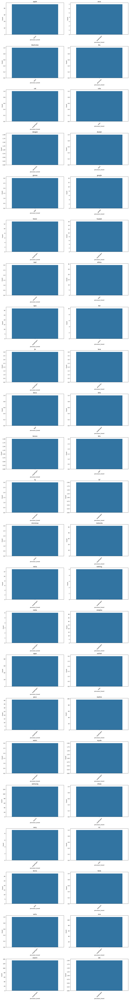

In [99]:
# filling the Nan values in processor brand by grouping brands and then using mode of the processors used in each 
data['processor_brand'] = data.groupby('brand_name')['processor_brand'].transform(lambda x: x.mode()[0] if not x.mode().empty else 'Unknown')

# Count the occurrences of each processor per brand
processor_counts = data.groupby(['brand_name', 'processor_brand']).size().reset_index(name='Count')

# Get unique brands
unique_brands = processor_counts['brand_name'].unique()
num_brands = len(unique_brands)
num_cols = 2
num_rows = math.ceil(num_brands / num_cols)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for i, brand in enumerate(unique_brands):
    brand_data = processor_counts[processor_counts['brand_name'] == brand]
    sns.barplot(x='processor_brand', y='Count', data=brand_data, ax=axes[i])
    axes[i].set_title(brand)
    axes[i].set_xlabel("processor_brand")
    axes[i].set_ylabel("Count")
    axes[i].tick_params(axis='x', rotation=45)

# Hide unused subplots if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

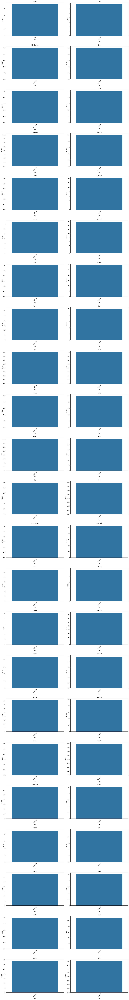

In [100]:
# filling the Nan values in os brand by grouping brands and then using mode of the processors used in each 
data['os'] = data.groupby('brand_name')['os'].transform(lambda x: x.mode()[0] if not x.mode().empty else 'Unknown')

# Count the occurrences of each os per brand
processor_counts = data.groupby(['brand_name', 'os']).size().reset_index(name='Count')

# Get unique brands
unique_brands = processor_counts['brand_name'].unique()
num_brands = len(unique_brands)
num_cols = 2
num_rows = math.ceil(num_brands / num_cols)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for i, brand in enumerate(unique_brands):
    brand_data = processor_counts[processor_counts['brand_name'] == brand]
    sns.barplot(x='os', y='Count', data=brand_data, ax=axes[i])
    axes[i].set_title(brand)
    axes[i].set_xlabel("os")
    axes[i].set_ylabel("Count")
    axes[i].tick_params(axis='x', rotation=45)

# Hide unused subplots if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

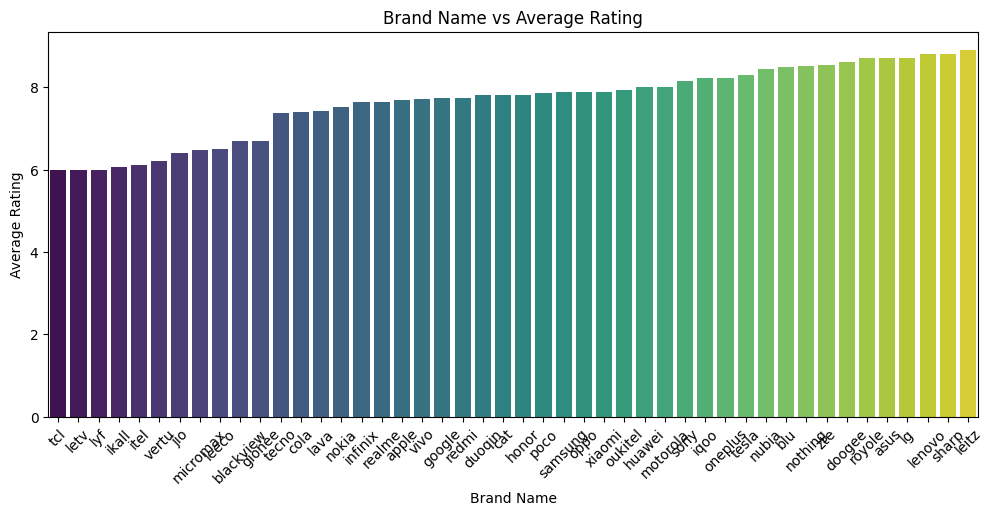

In [101]:
brand_avg_rating = data.groupby('brand_name')['avg_rating'].mean().sort_values()

plt.figure(figsize=(12, 5))
sns.barplot(x=brand_avg_rating.index, y=brand_avg_rating.values, palette="viridis")
plt.xticks(rotation=45)
plt.title('Brand Name vs Average Rating')
plt.xlabel('Brand Name')
plt.ylabel('Average Rating')
plt.show()

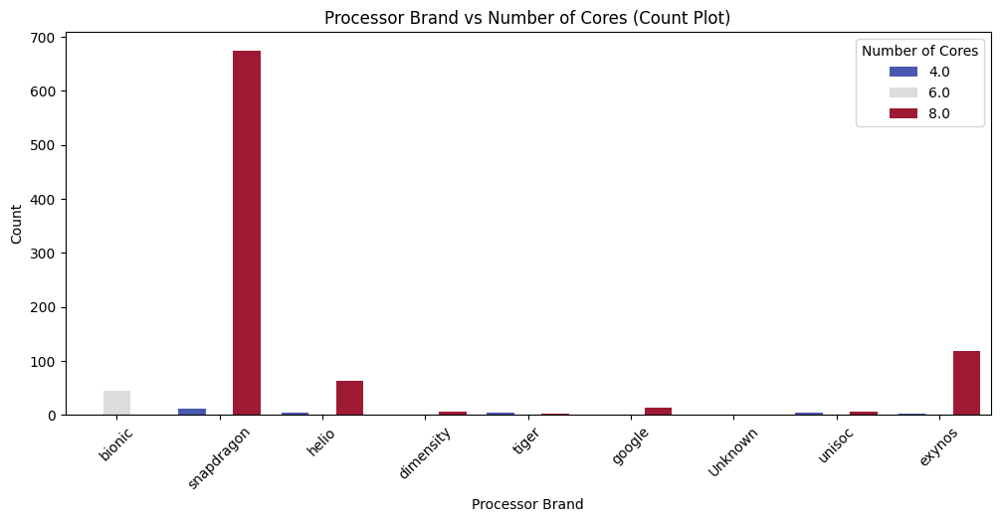

In [102]:
plt.figure(figsize=(12, 5))
sns.countplot(data=data, x='processor_brand', hue='num_cores', palette="coolwarm")
plt.xticks(rotation=45)
plt.title('Processor Brand vs Number of Cores (Count Plot)')
plt.xlabel('Processor Brand')
plt.ylabel('Count')
plt.legend(title='Number of Cores')
plt.show()

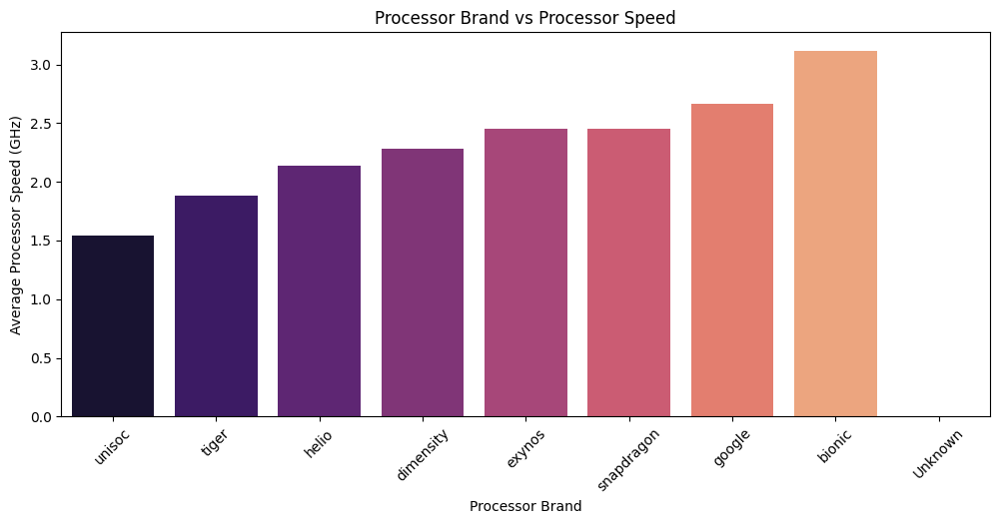

In [103]:
processor_speed = data.groupby('processor_brand')['processor_speed'].mean().sort_values()

plt.figure(figsize=(12, 5))
sns.barplot(x=processor_speed.index, y=processor_speed.values, palette="magma")
plt.xticks(rotation=45)
plt.title('Processor Brand vs Processor Speed')
plt.xlabel('Processor Brand')
plt.ylabel('Average Processor Speed (GHz)')
plt.show()

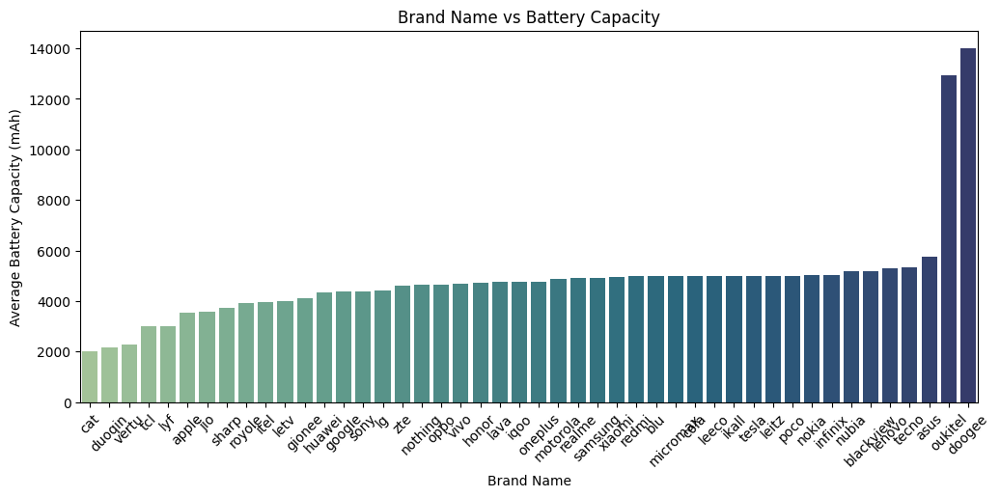

In [104]:
brand_battery = data.groupby('brand_name')['battery_capacity'].mean().sort_values()

plt.figure(figsize=(12, 5))
sns.barplot(x=brand_battery.index, y=brand_battery.values, palette="crest")
plt.xticks(rotation=45)
plt.title('Brand Name vs Battery Capacity')
plt.xlabel('Brand Name')
plt.ylabel('Average Battery Capacity (mAh)')
plt.show()

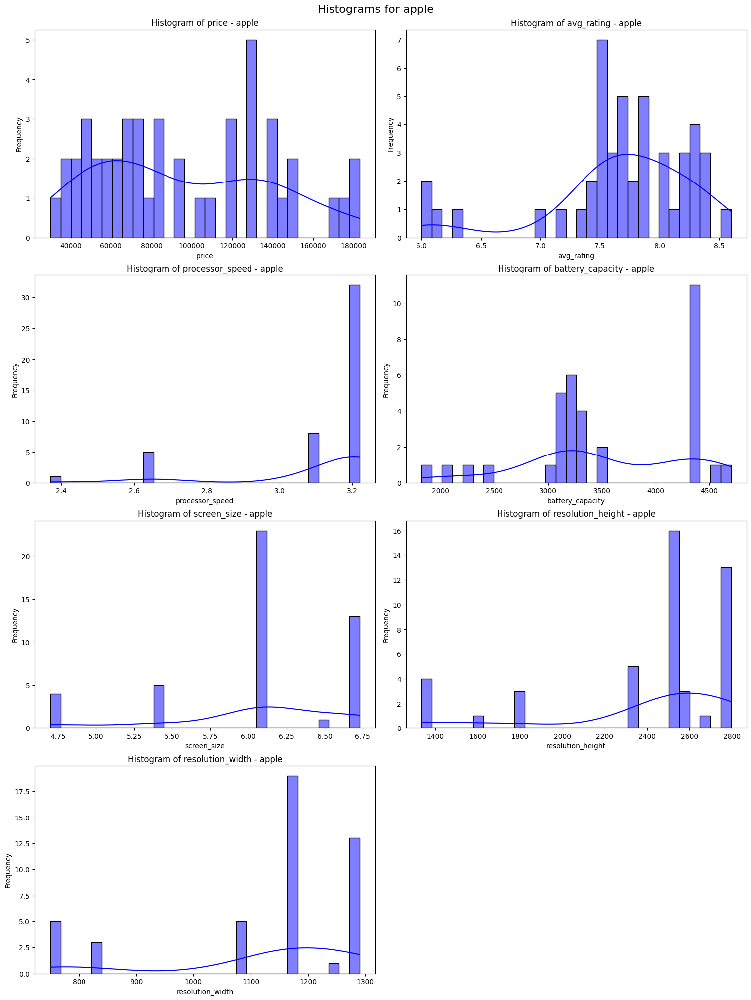

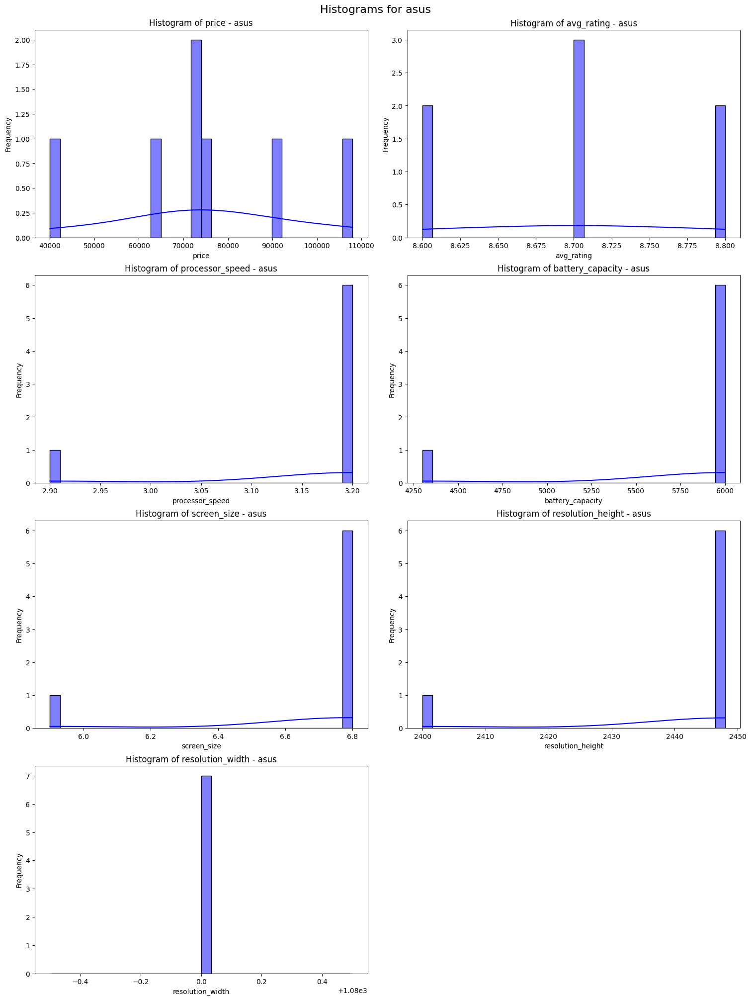

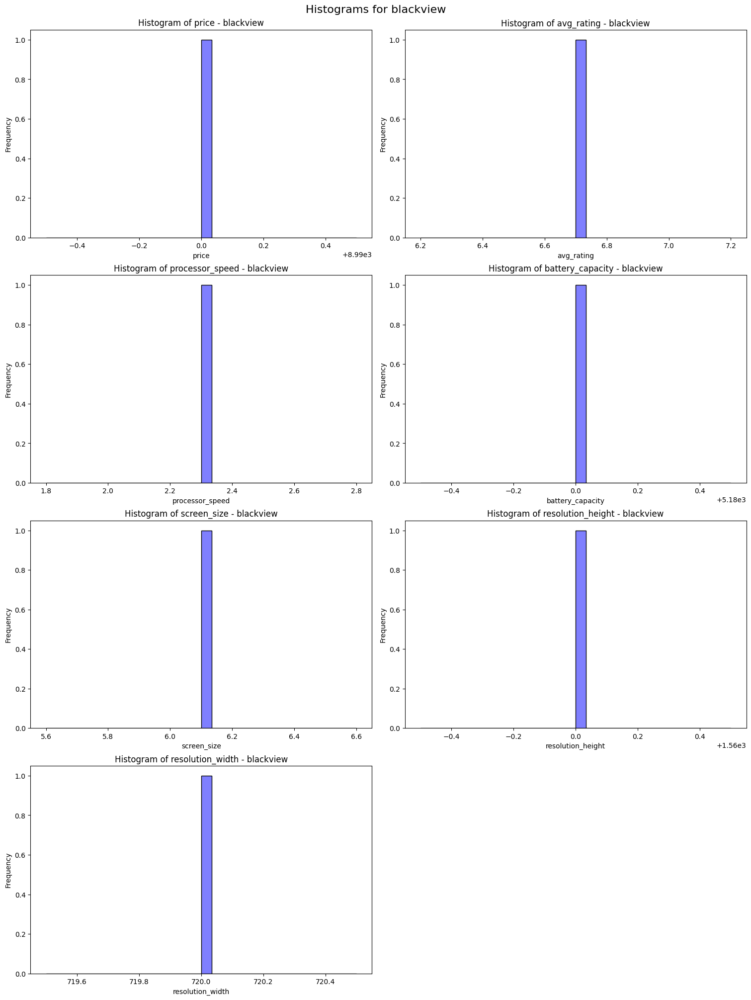

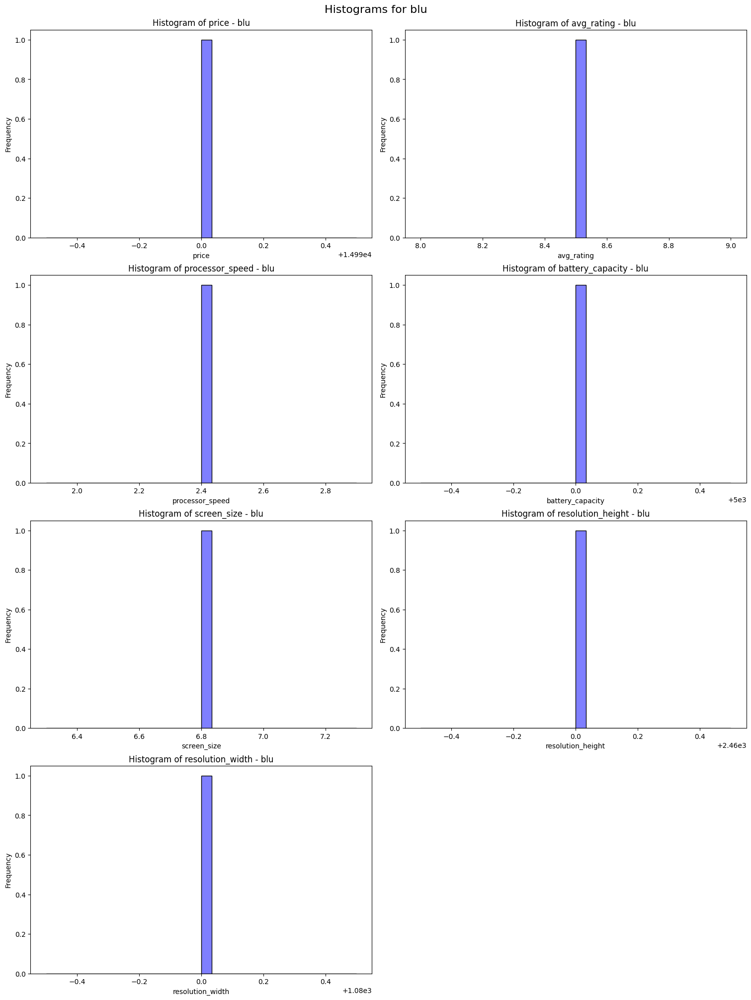

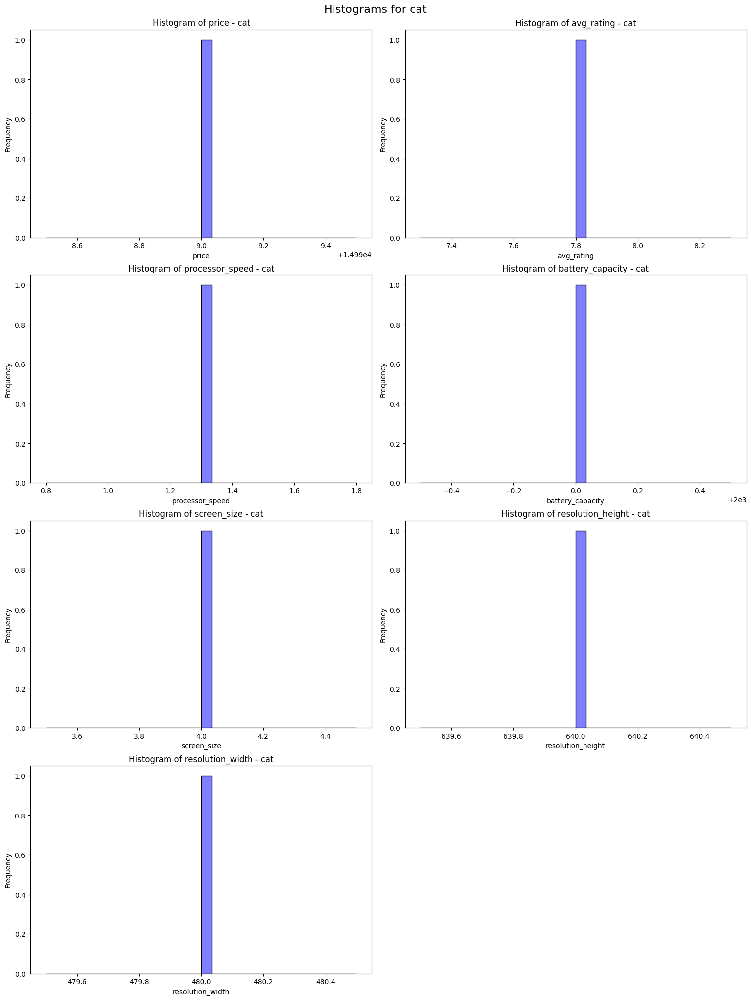

...

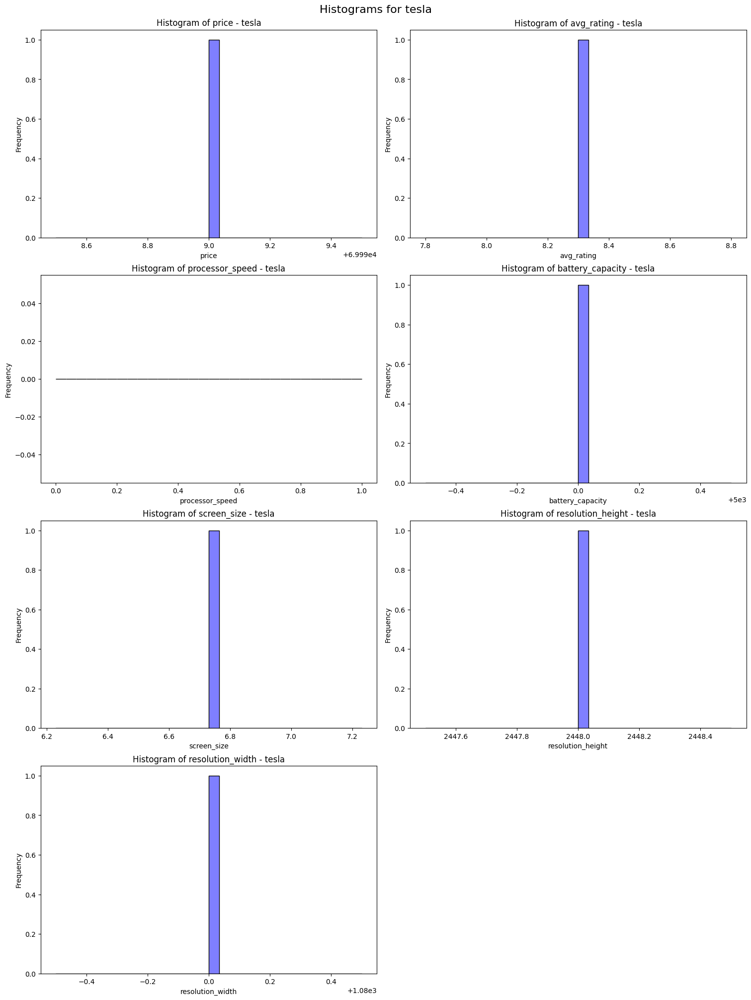

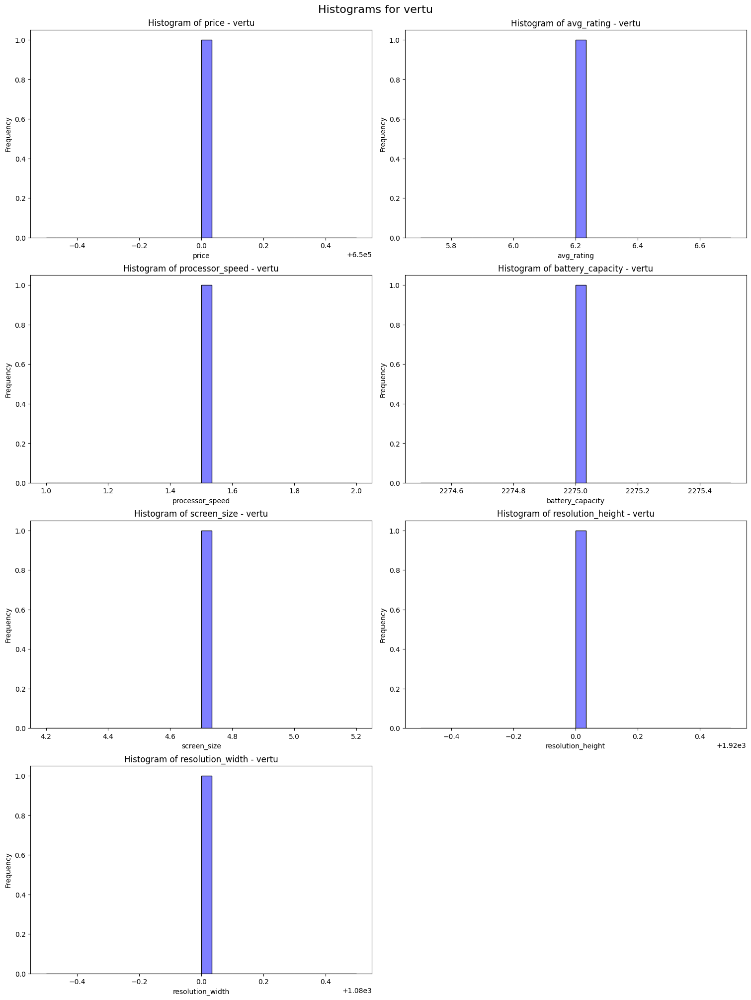

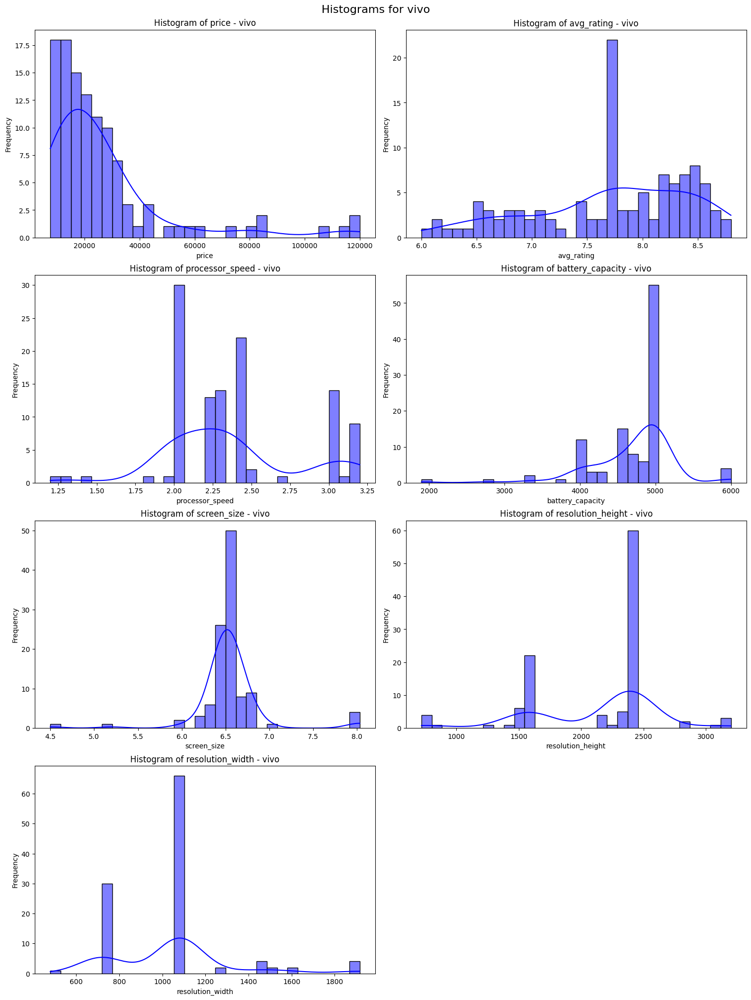

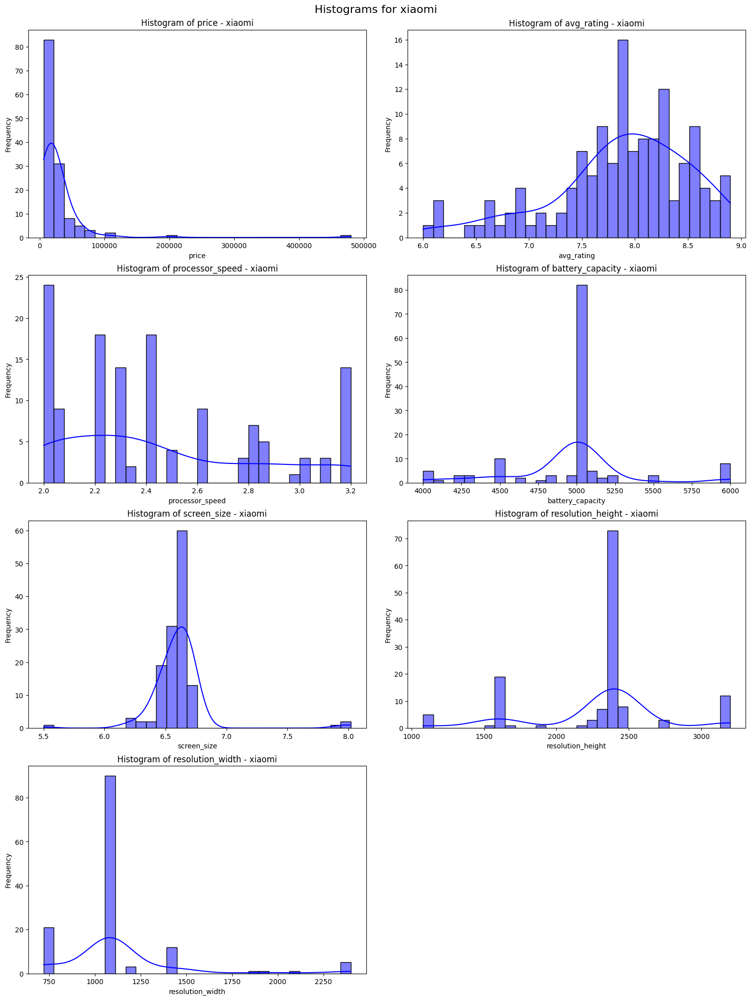

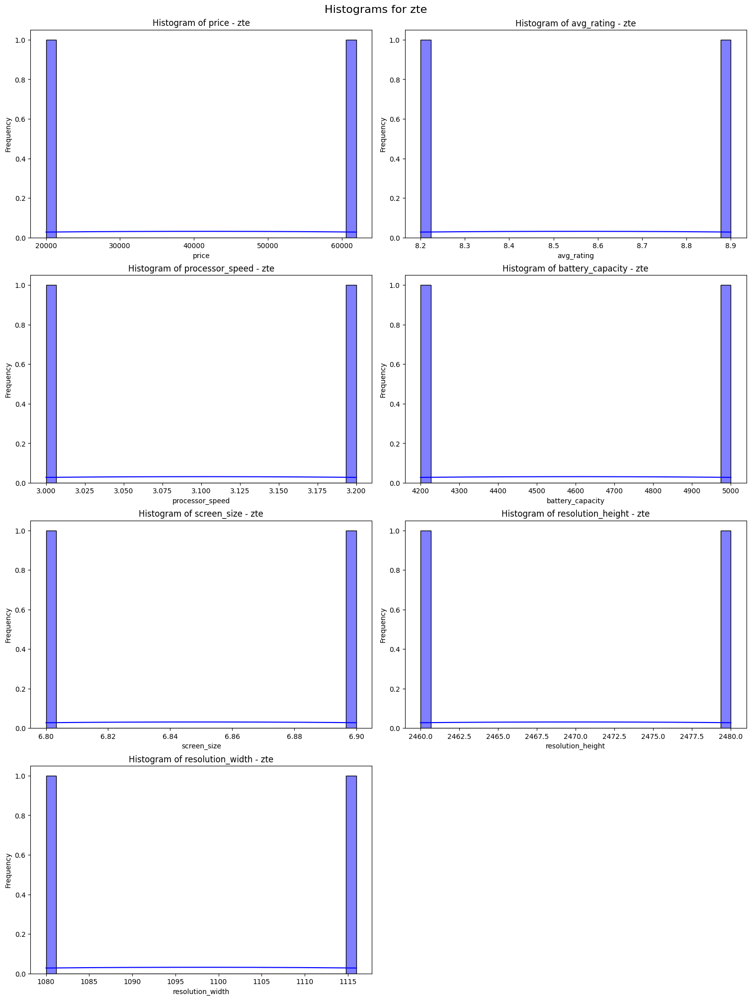

In [105]:
numerical_cols = data.select_dtypes(include=['number']).columns

high_cardinality_cols = [col for col in numerical_cols if data[col].nunique() > 20]
unique_brands = data['brand_name'].unique()

# Loop through each brand
for brand in unique_brands:
    brand_data = data[data['brand_name'] == brand]  # Filter data for current brand
    
    # Create subplots: Adjust rows based on the number of features
    num_features = len(high_cardinality_cols)
    num_rows = (num_features // 2) + (num_features % 2)  # 2 columns layout
    fig, axes = plt.subplots(num_rows, 2, figsize=(15, 5 * num_rows), constrained_layout=True)
    axes = axes.flatten()  # Flatten to easily index subplots
    
    # Plot histogram for each feature
    for i, col in enumerate(high_cardinality_cols):
        sns.histplot(brand_data[col], bins=30, kde=True, ax=axes[i], color='blue')
        axes[i].set_title(f'Histogram of {col} - {brand}')
        axes[i].set_xlabel(col)
        axes[i].set_ylabel('Frequency')

    # Hide empty subplots if needed
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle(f'Histograms for {brand}', fontsize=16)
    plt.show()

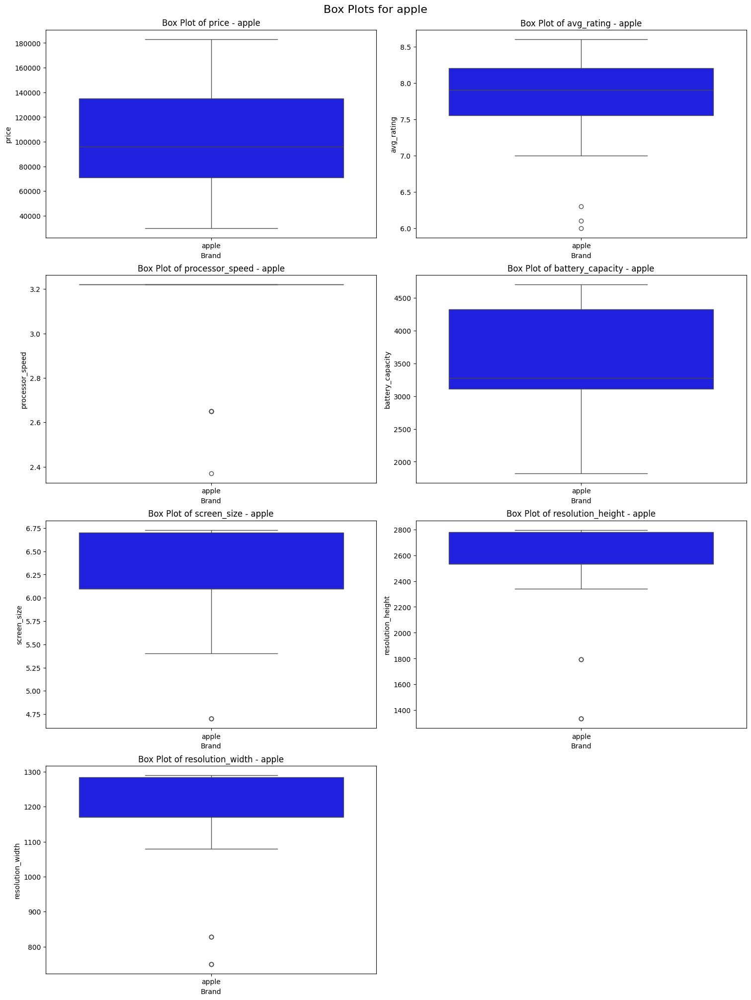

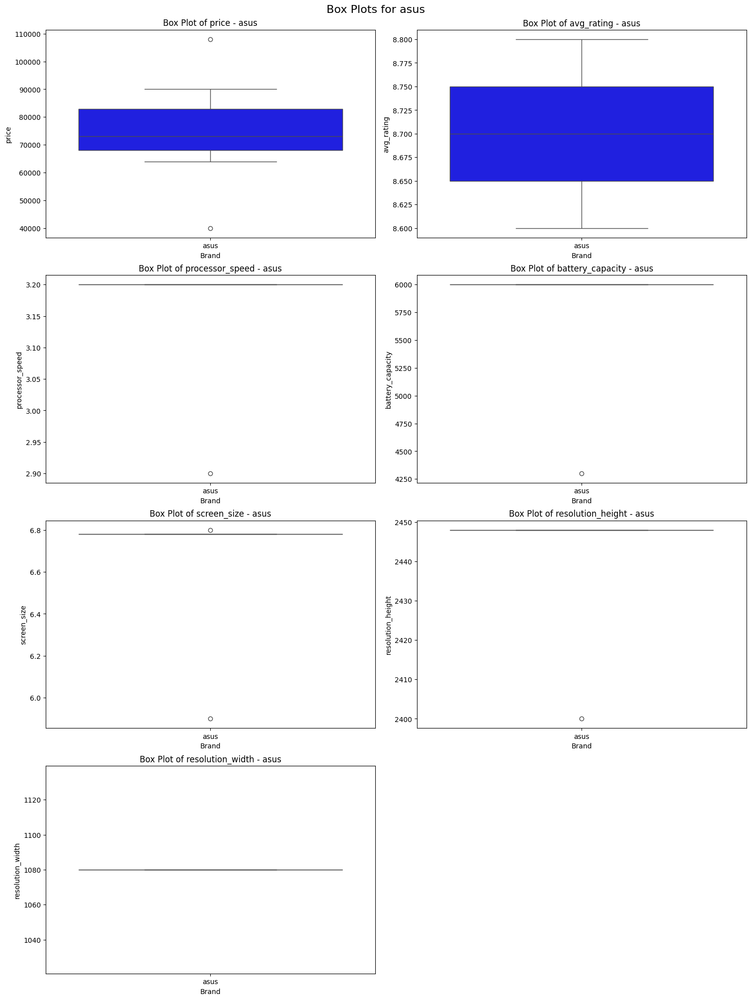

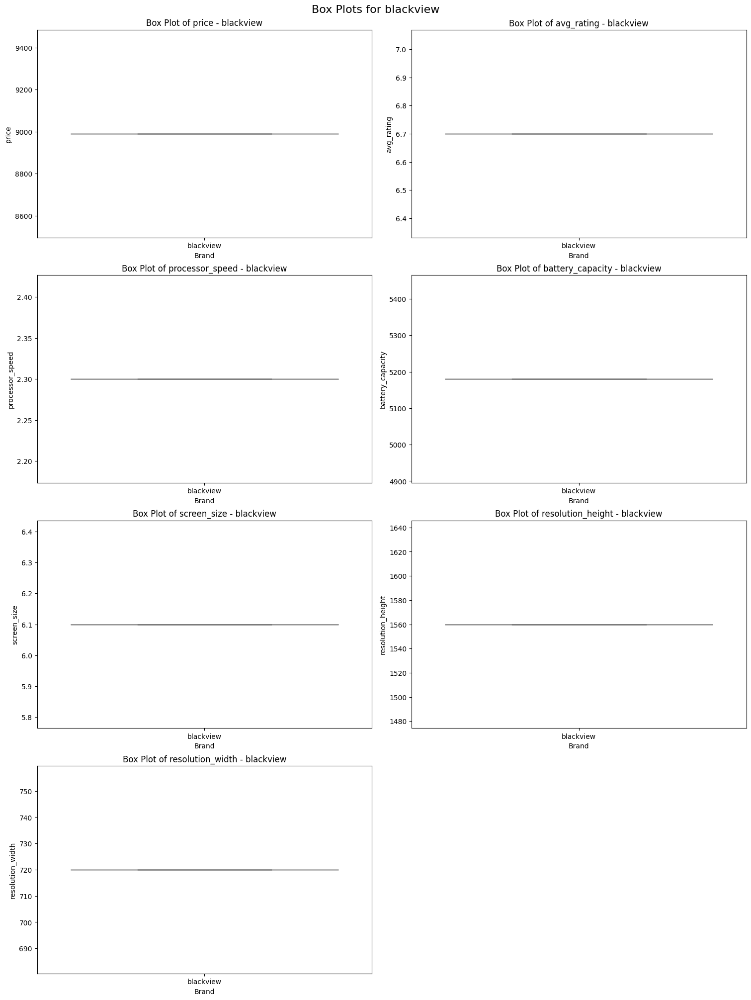

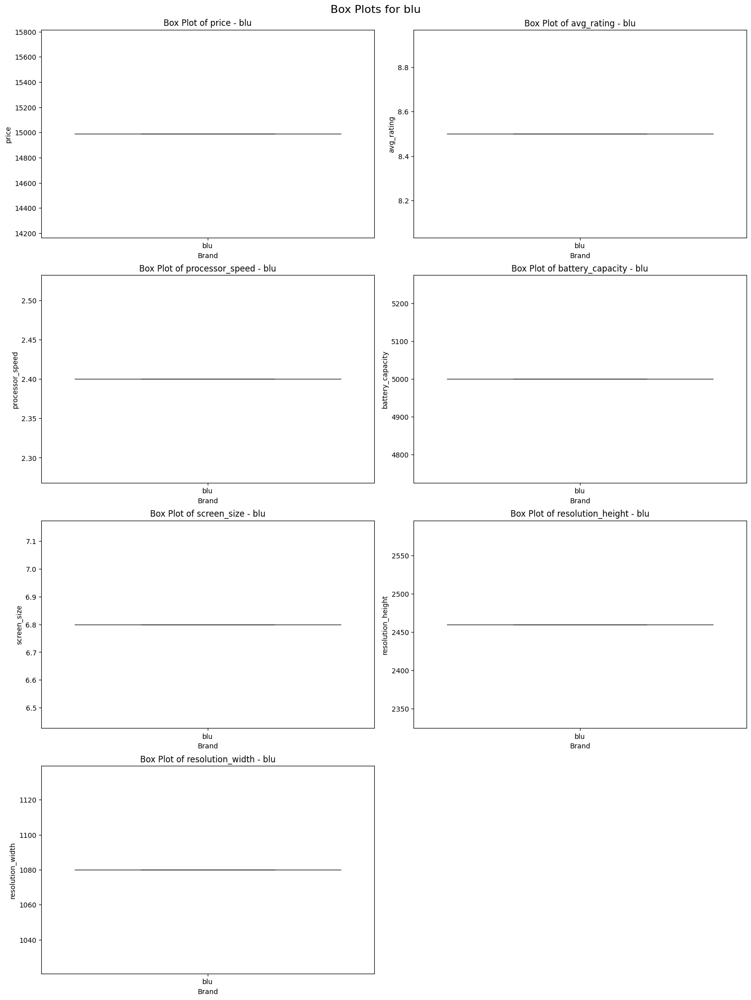

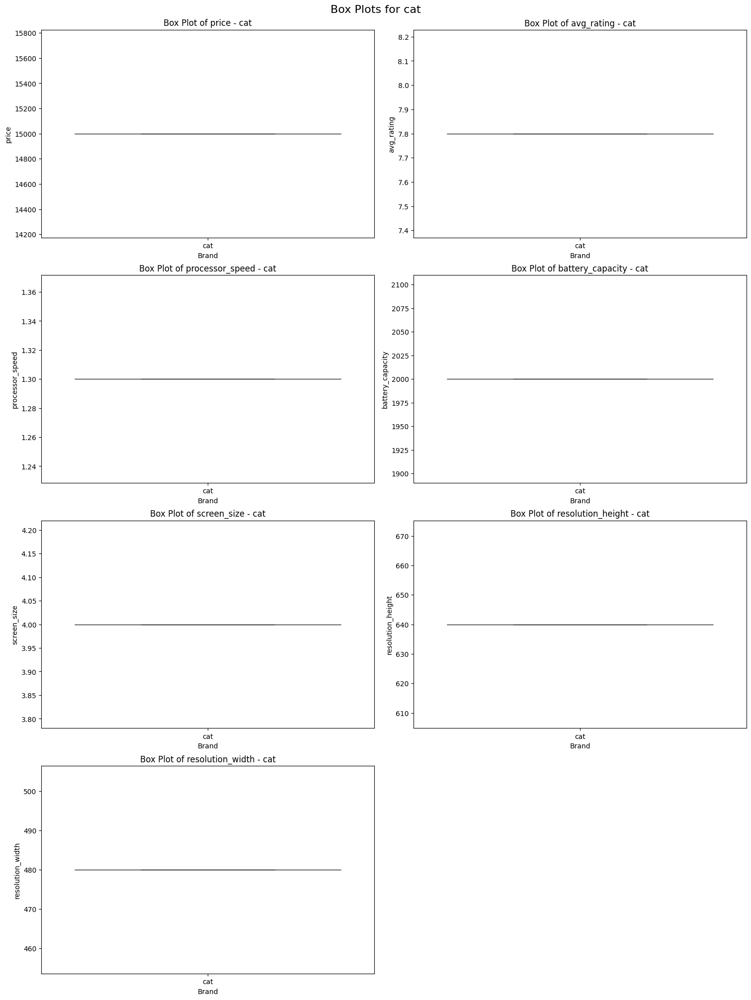

...

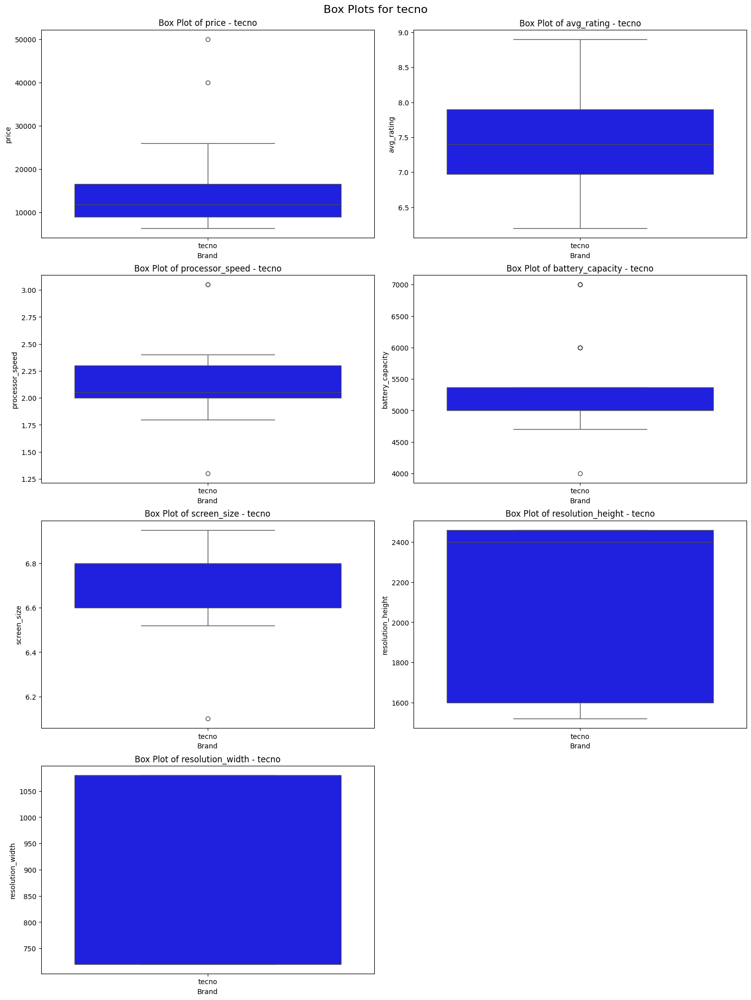

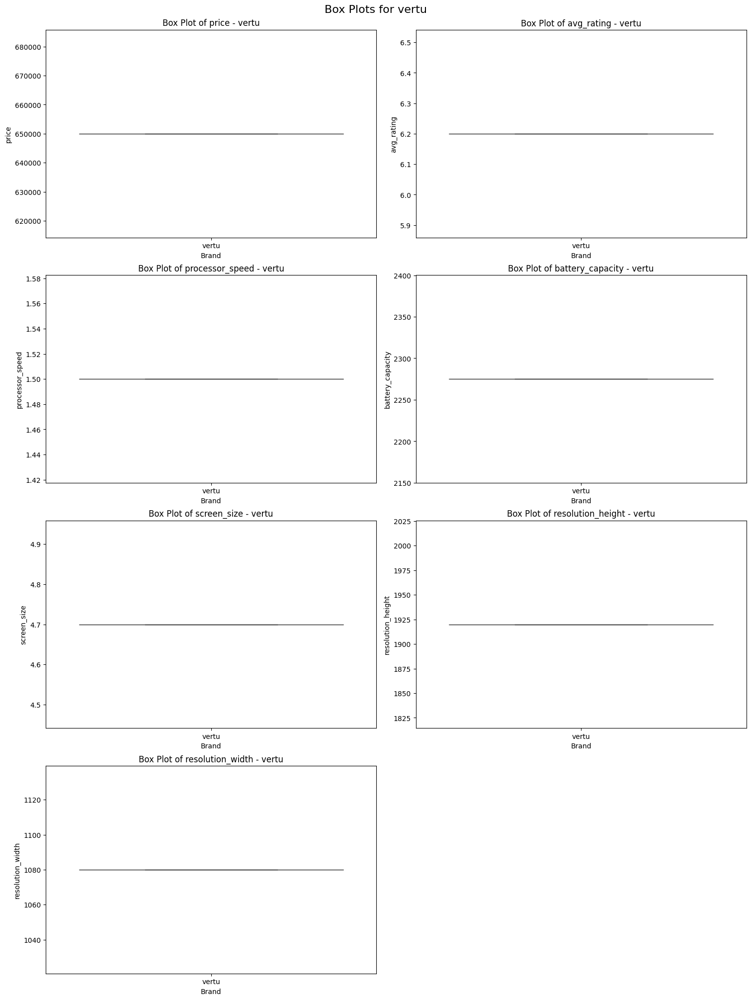

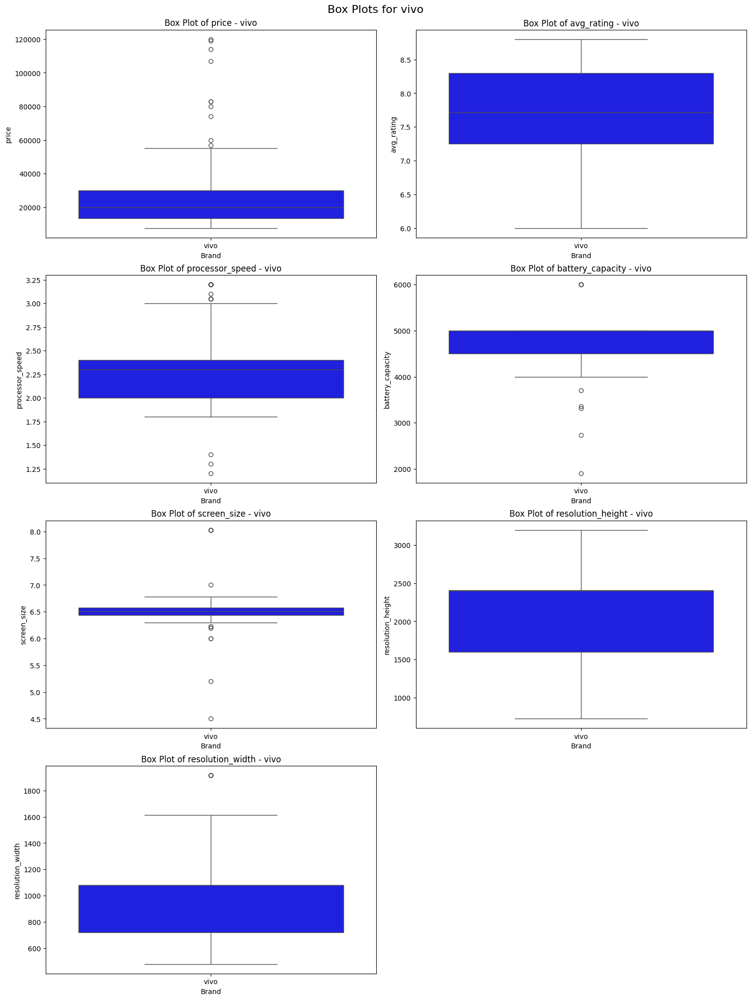

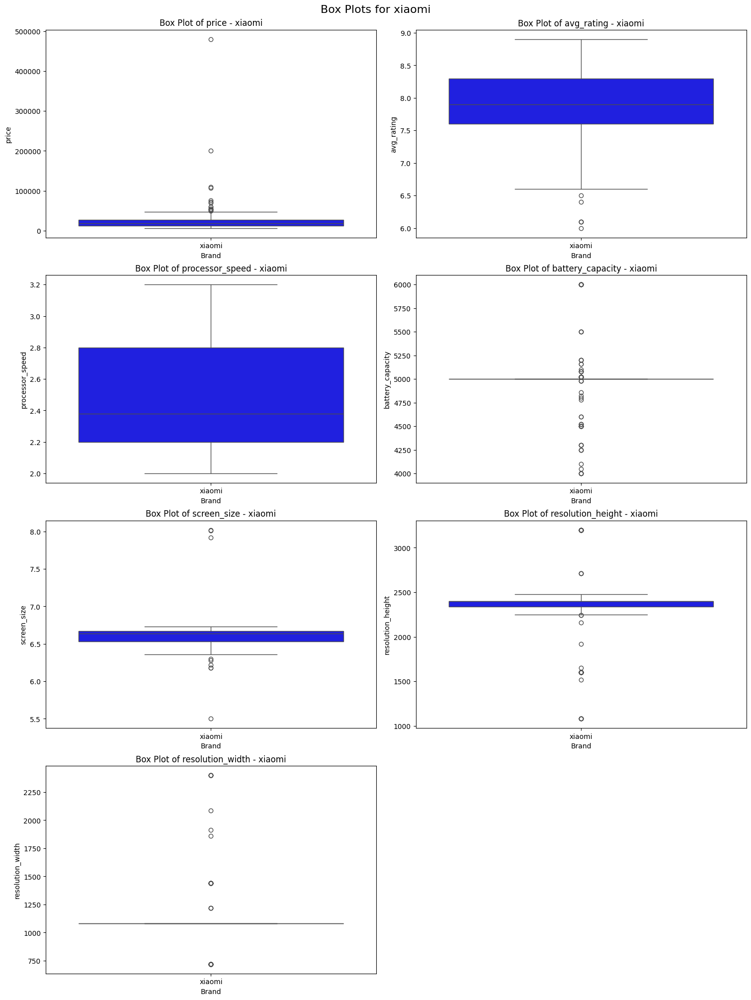

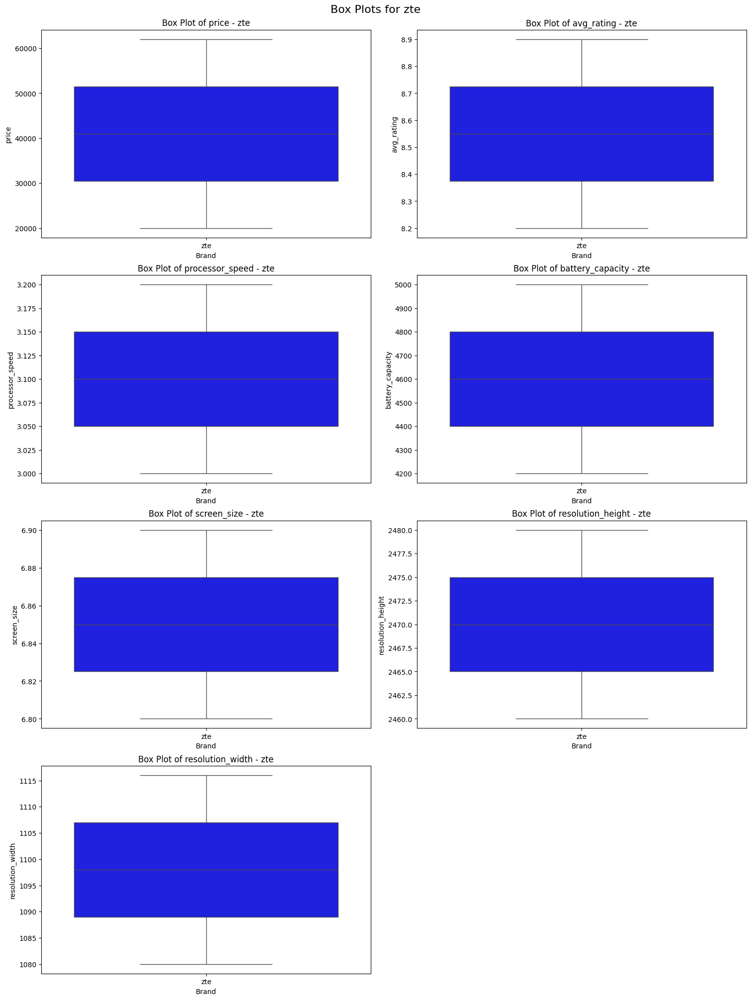

In [106]:
for brand in unique_brands:
    brand_data = data[data['brand_name'] == brand]  # Filter data for the current brand
    
    # Ensure there's data to plot
    brand_data = brand_data.dropna(subset=high_cardinality_cols)
    
    if brand_data.empty:
        continue  # Skip empty brand data
    
    # Define the number of rows based on features count (2 columns per row)
    num_features = len(high_cardinality_cols)
    num_rows = (num_features // 2) + (num_features % 2)  # 2-column layout
    fig, axes = plt.subplots(num_rows, 2, figsize=(15, 5 * num_rows), constrained_layout=True)
    axes = axes.flatten()  # Flatten to easily index subplots
    
    # Plot boxplots for each high-cardinality feature
    for i, col in enumerate(high_cardinality_cols):
        if brand_data[col].nunique() > 0:  # Ensure column has values to plot
            sns.boxplot(x=[brand] * len(brand_data), y=brand_data[col], ax=axes[i], color='blue')
            axes[i].set_title(f'Box Plot of {col} - {brand}')
            axes[i].set_xlabel("Brand")
            axes[i].set_ylabel(col)
    
    # Hide empty subplots if needed
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle(f'Box Plots for {brand}', fontsize=16)
    plt.show()

In [107]:
# summary statistics
data.describe()

,price,avg_rating,5G_or_not,num_cores,processor_speed,battery_capacity,fast_charging_available,ram_capacity,internal_memory,screen_size,refresh_rate,num_rear_cameras,primary_camera_rear,primary_camera_front,extended_memory_available,resolution_height,resolution_width
count,980.000000,980.000000,980.000000,960.000000,960.000000,969.000000,980.000000,980.000000,980.000000,980.000000,980.000000,980.000000,980.000000,980.000000,980.000000,980.000000,980.000000
mean,32520.504082,7.799381,0.560204,7.783333,2.451365,4817.748194,0.854082,6.560204,141.036735,6.536765,92.256122,2.814286,50.319286,16.580612,0.630612,2214.663265,1075.852041
std,39531.812669,0.735727,0.496616,0.798156,0.465847,1009.540054,0.353205,2.744378,107.134516,0.349162,28.988052,0.776441,33.000968,10.870706,0.482885,516.484254,290.164931
min,3499.000000,6.000000,0.000000,4.000000,1.200000,1821.000000,0.000000,1.000000,8.000000,3.540000,60.000000,1.000000,2.000000,0.000000,0.000000,480.000000,480.000000
25%,12999.000000,7.400000,0.000000,8.000000,2.050000,4500.000000,1.000000,4.000000,64.000000,6.500000,60.000000,2.000000,24.000000,8.000000,0.000000,1612.000000,1080.000000
50%,19994.500000,7.900000,1.000000,8.000000,2.400000,5000.000000,1.000000,6.000000,128.000000,6.580000,90.000000,3.000000,50.000000,16.000000,1.000000,2400.000000,1080.000000
75%,35491.500000,8.400000,1.000000,8.000000,2.850000,5000.000000,1.000000,8.000000,128.000000,6.670000,120.000000,3.000000,64.000000,16.000000,1.000000,2408.000000,1080.000000
max,650000.000000,8.900000,1.000000,8.000000,3.220000,22000.000000,1.000000,18.000000,1024.000000,8.030000,240.000000,4.000000,200.000000,60.000000,1.000000,3840.000000,2460.000000


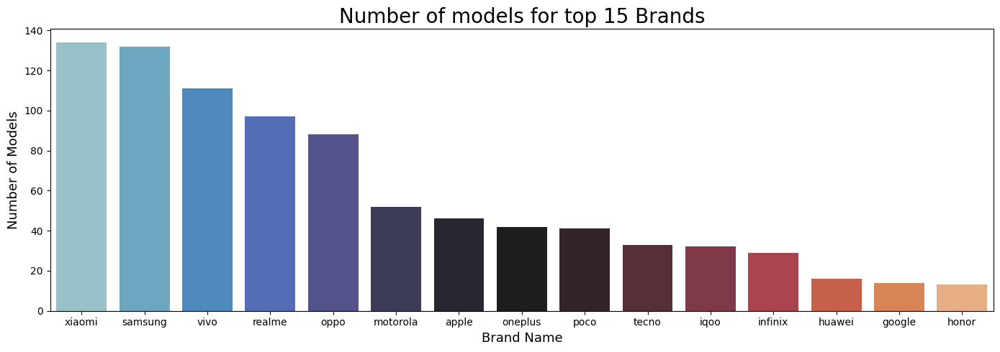

In [108]:
# plot for number of models for top 15 brands
plt.figure(figsize=(14,5))
brand_count = data.brand_name.value_counts().reset_index()
brand_count.head()

# Barplot
ax = sns.barplot(brand_count.head(15), x='brand_name', y='count', palette='icefire')

# Labels
plt.title('Number of models for top 15 Brands',fontsize=20)
plt.xlabel('Brand Name',fontsize=13)
plt.ylabel('Number of Models',fontsize=13)
plt.tight_layout()
plt.show()

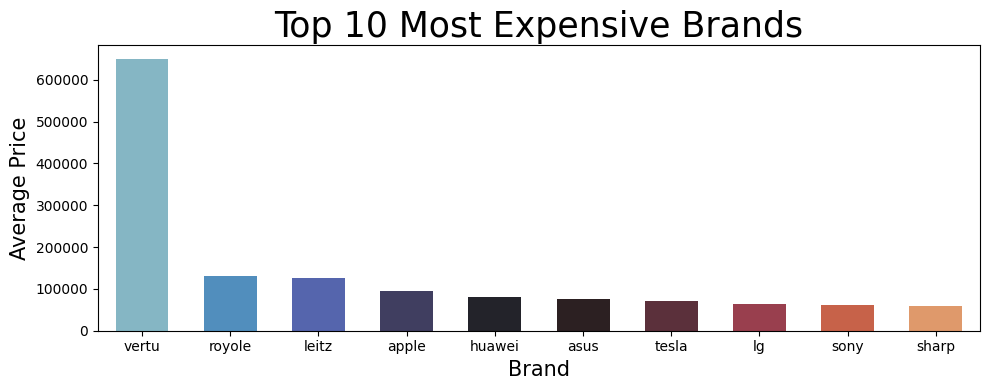

In [109]:
# plot for top 10 most expensive brands
plt.figure(figsize=(10,4))

# average price for each brand 
avg_price = data.groupby('brand_name')['price'].mean().reset_index()
avg_price = avg_price.sort_values(by='price',ascending=False)
avg_price.head()

# Plot
ax = sns.barplot(data=avg_price.head(10),x='brand_name',y='price',palette='icefire',width=0.6)

# Labels
plt.xlabel('Brand',fontsize=15)
plt.ylabel('Average Price',fontsize=15)
plt.title('Top 10 Most Expensive Brands',fontsize=25)
plt.tight_layout()
plt.show()

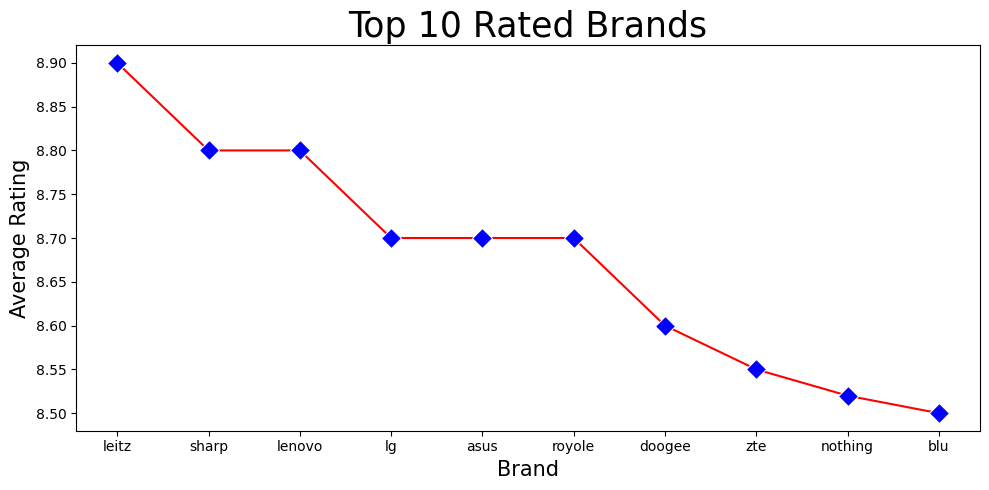

In [110]:
# average rating for each brand 
avg_rating = data.groupby('brand_name')['avg_rating'].mean().reset_index()
avg_rating = avg_rating.sort_values(by='avg_rating',ascending=False)
avg_rating.head()

# Lineplot for top 10 rated brands
plt.figure(figsize=(10,5))

# plot
sns.lineplot(data=avg_rating.head(10),x='brand_name',y='avg_rating',marker='D',color='red',markersize=10, markerfacecolor='blue')

#Labels
plt.xlabel('Brand',fontsize=15)
plt.ylabel('Average Rating',fontsize=15)
plt.title('Top 10 Rated Brands',fontsize=25)
plt.tight_layout()
plt.show()

In [111]:
# the price column has positive skew
data['price'].skew()

6.591790999665569

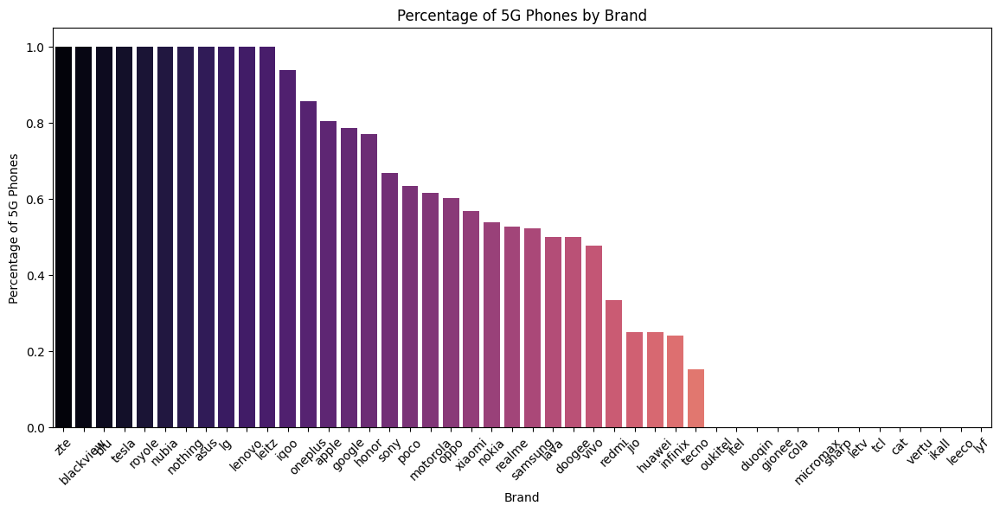

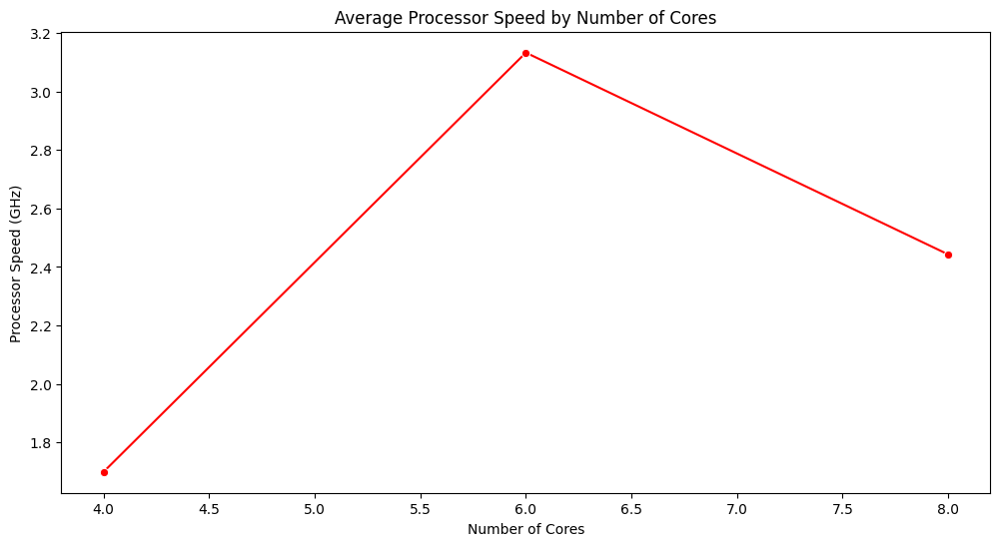

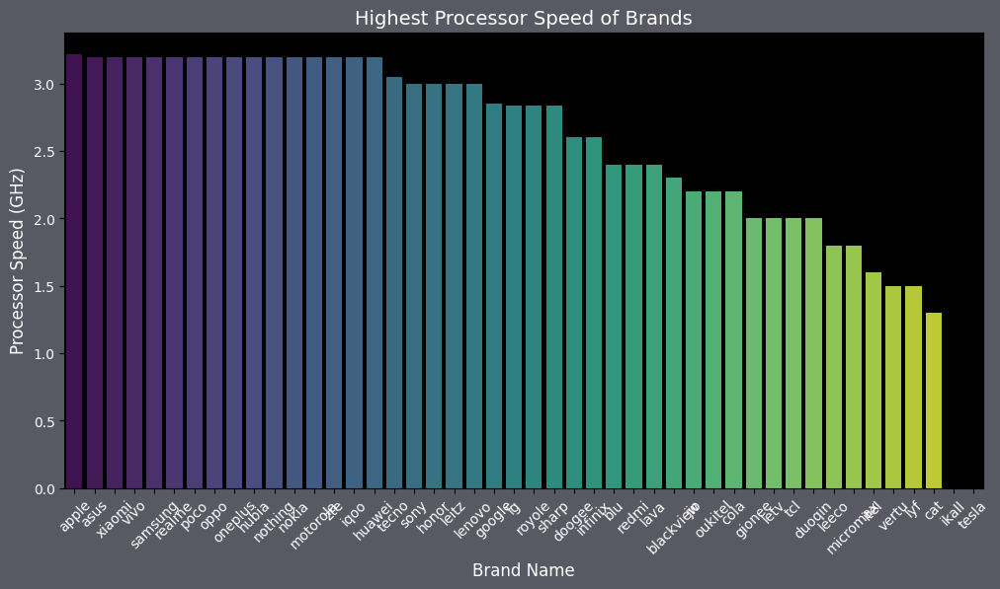

In [113]:
# Grouped comparisons:
# 5G Adoption by Brand
brand_5g = data.groupby("brand_name")["5G_or_not"].mean().reset_index().sort_values(by="5G_or_not", ascending=False)
plt.figure(figsize=(14, 6))
sns.barplot(x="brand_name", y="5G_or_not", data=brand_5g, palette="magma")
plt.xticks(rotation=45)
plt.title("Percentage of 5G Phones by Brand")
plt.xlabel("Brand")
plt.ylabel("Percentage of 5G Phones")
plt.show()

# Processor Speed by Number of Cores
core_speed = data.groupby("num_cores")["processor_speed"].mean().reset_index()
plt.figure(figsize=(12, 6))
sns.lineplot(x="num_cores", y="processor_speed", data=core_speed, marker="o", color="red")
plt.title("Average Processor Speed by Number of Cores")
plt.xlabel("Number of Cores")
plt.ylabel("Processor Speed (GHz)")
plt.show()

max_processor_speed_by_brand = data.groupby('brand_name')['processor_speed'].max().reset_index()

max_processor_speed_by_brand = max_processor_speed_by_brand.sort_values(by='processor_speed', ascending=False)

fig, ax = plt.subplots(figsize=(12, 6))

# Bar chart using Seaborn
sns.barplot(x=max_processor_speed_by_brand['brand_name'], 
            y=max_processor_speed_by_brand['processor_speed'], 
            palette="viridis", ax=ax)

# Customize the plot
ax.set_title("Highest Processor Speed of Brands", fontsize=14, color="white")
ax.set_xlabel("Brand Name", fontsize=12, color="white")
ax.set_ylabel("Processor Speed (GHz)", fontsize=12, color="white")
ax.set_facecolor("black")  # Set plot background color
fig.patch.set_facecolor("#595964")  # Set figure background color

# Rotate x-axis labels for readability
plt.xticks(rotation=45, color="white")
plt.yticks(color="white")

# Show the plot
plt.show()

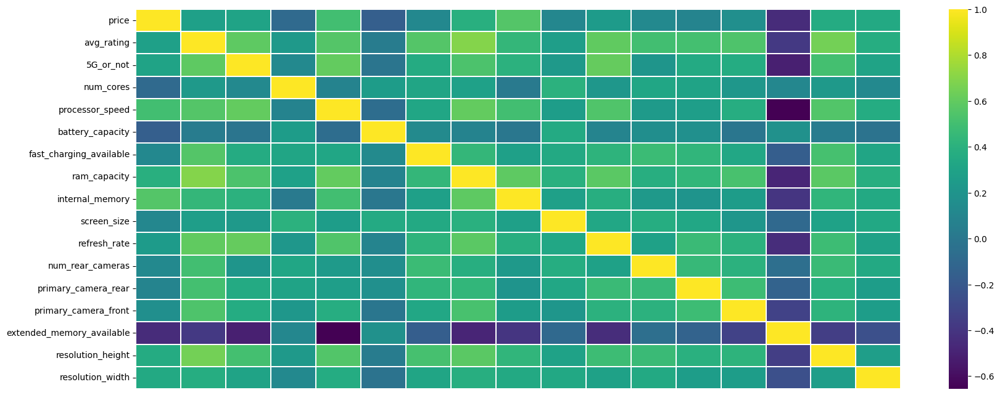

In [115]:
# heatmap to show the correlation of variables 
numeric_cols = data.select_dtypes(include=[np.number]).columns.tolist()
plt.figure(figsize=(20,8))
corr = data[numeric_cols].corr()
sns.heatmap(corr,cmap='viridis', linewidths=0.2, xticklabels=False)
plt.show()

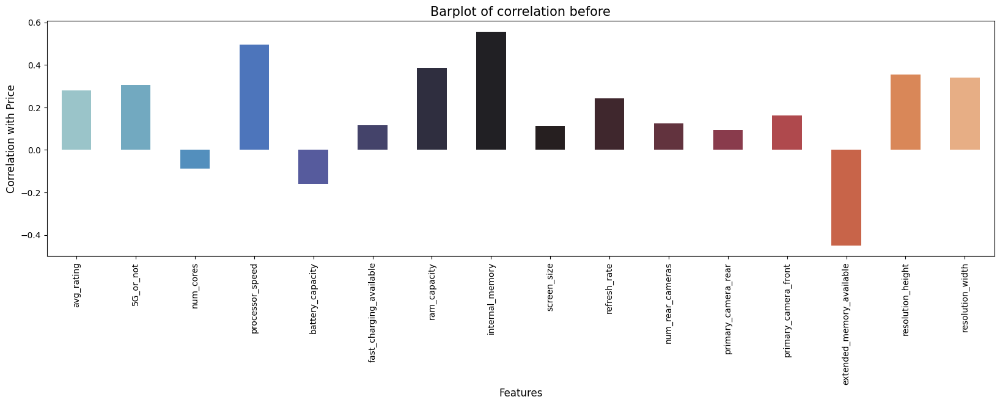

In [116]:
# Feature correlation for the price of the smartphone
feature_imp = data[numeric_cols].corr()['price'].drop('price',axis=0).reset_index()

# Barplot to show the correlation
plt.figure(figsize=(20,5))
sns.barplot(feature_imp,x= 'index', y='price', width=0.5, palette='icefire')
plt.title('Barplot of correlation before', fontsize=15)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Correlation with Price', fontsize=12)
plt.xticks(rotation=90)
plt.show()

In [122]:
# Standardize categorical values:
le = LabelEncoder()
for col in data.columns:
    if data[col].dtype == "object":
        data[col] = data[col].astype(str)
        data[col + "_standardized"] = le.fit_transform(data[col])

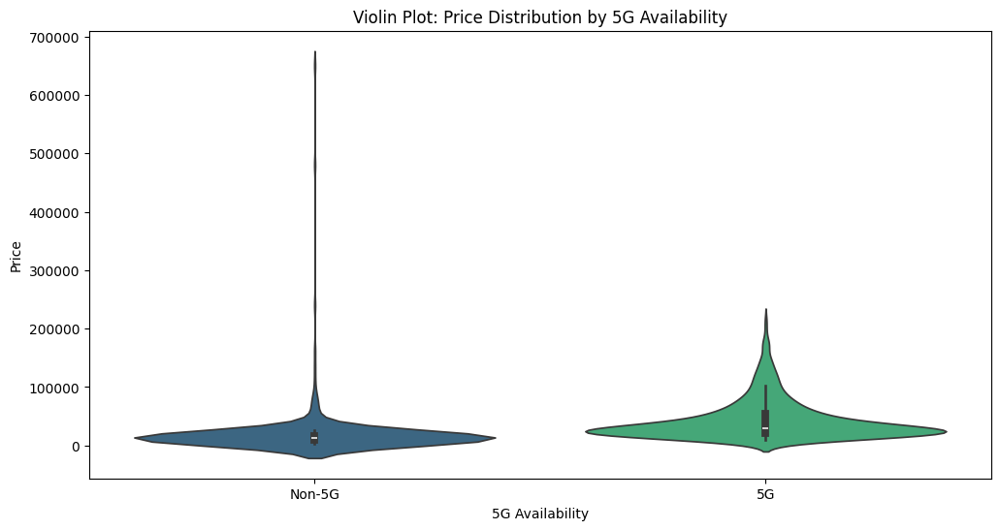

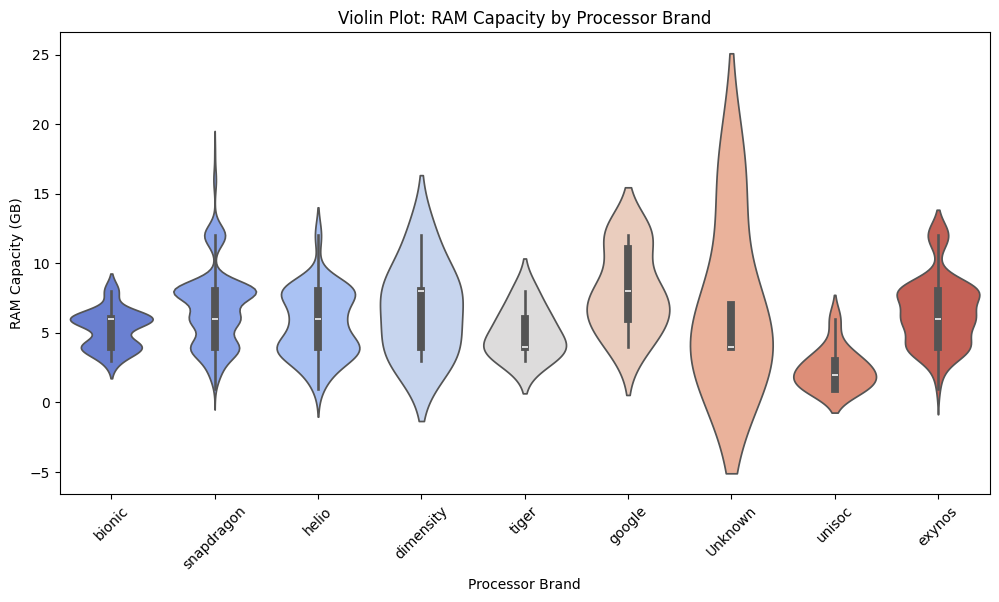

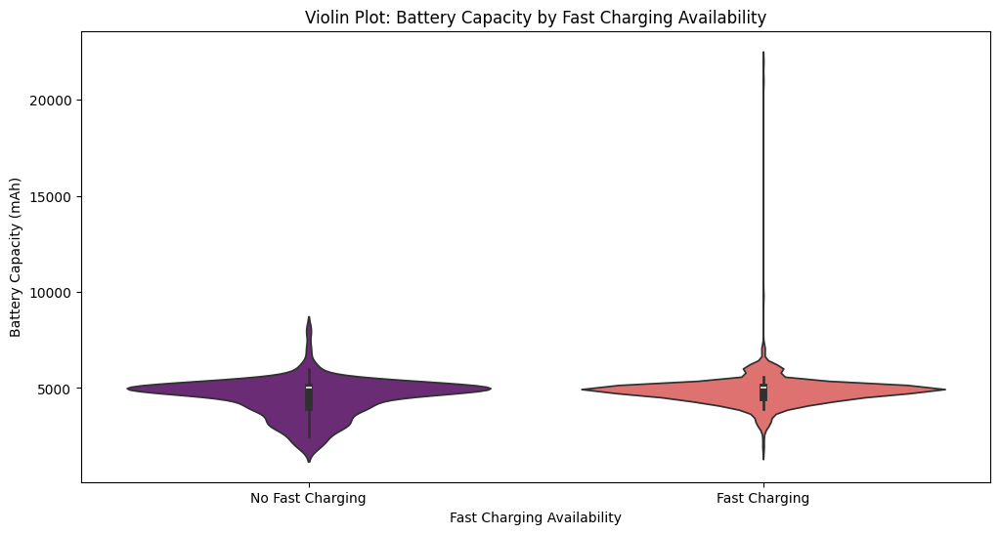

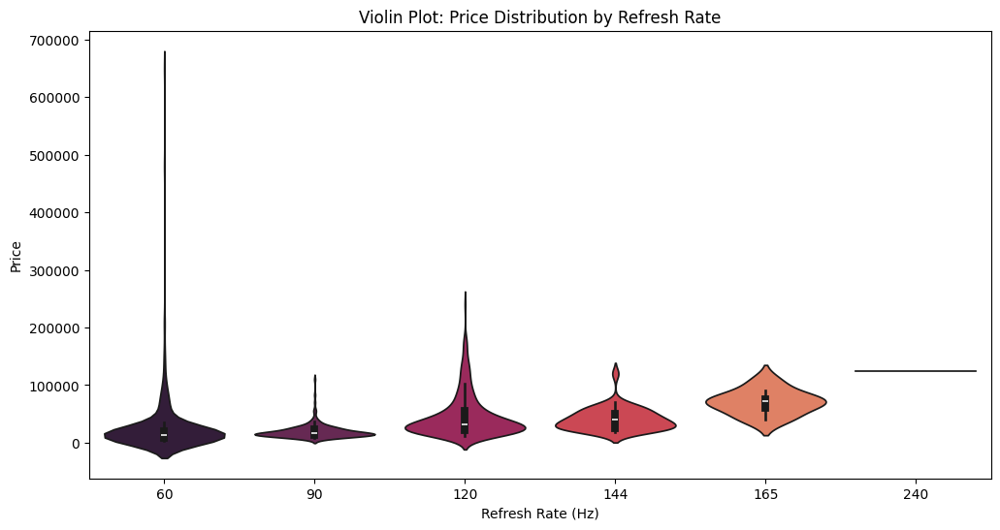

In [124]:
# Violin Plot 1: Price vs 5G Availability
plt.figure(figsize=(12, 6))
sns.violinplot(x='5G_or_not', y='price', data=data, palette="viridis")
plt.xticks([0, 1], ['Non-5G', '5G'])
plt.title("Violin Plot: Price Distribution by 5G Availability")
plt.xlabel("5G Availability")
plt.ylabel("Price")
plt.show()

# Violin Plot 2: RAM Capacity vs Processor Brand
plt.figure(figsize=(12, 6))
sns.violinplot(x='processor_brand', y='ram_capacity', data=data, palette="coolwarm")
plt.xticks(rotation=45)
plt.title("Violin Plot: RAM Capacity by Processor Brand")
plt.xlabel("Processor Brand")
plt.ylabel("RAM Capacity (GB)")
plt.show()

# Violin Plot 3: Battery vs Fast Charging Availability
plt.figure(figsize=(12, 6))
sns.violinplot(x='fast_charging_available', y='battery_capacity', data=data, palette="magma")
plt.xticks([0, 1], ['No Fast Charging', 'Fast Charging'])
plt.title("Violin Plot: Battery Capacity by Fast Charging Availability")
plt.xlabel("Fast Charging Availability")
plt.ylabel("Battery Capacity (mAh)")
plt.show()

# Violin Plot 4: Refresh Rate vs Price
plt.figure(figsize=(12, 6))
sns.violinplot(x='refresh_rate', y='price', data=data, palette="rocket")
plt.title("Violin Plot: Price Distribution by Refresh Rate")
plt.xlabel("Refresh Rate (Hz)")
plt.ylabel("Price")
plt.show()

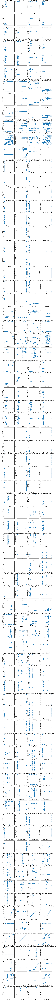

In [121]:
plots_per_row = 4
numeric_cols = data.select_dtypes(include=[np.number]).columns.tolist()

# Generate all possible numeric column pairs
col_pairs = list(itertools.combinations(numeric_cols, 2))
total_plots = len(col_pairs)
rows = (total_plots // plots_per_row) + (total_plots % plots_per_row > 0)

fig, axes = plt.subplots(rows, plots_per_row, figsize=(18, rows * 5))
axes = axes.flatten()  

# Loop through each pair and create scatter plots
for i, (col_x, col_y) in enumerate(col_pairs):
    sns.scatterplot(x=data[col_x], y=data[col_y], ax=axes[i])
    axes[i].set_title(f'{col_x} vs {col_y}')